# **Lab 6: IIR Filtering**


The objective for this lab is to help you understand the relationship between the location
of poles and zeros in the z-domain, the impulse response h[n] in the n-domain, and the frequency
response $H(e^{j\omega})$. We use the system function,
represented as a ratio of polynomials in $z^{-1}$, which can be expressed in either factored or expanded form as:

$$
H(z) = G\frac{\prod_{k=1}^M (1-z_kz^{-1}) }{\prod_{k=1}^N (1-p_kz^{-1})} = \frac{ \sum_{k=0}^M b_kz^{-k}}{ 1- \sum_{k=1}^N a_kz^{-k} }
$$

Authors:
*   Marc Bosch Manzano. U215231.
*   Arnau Balart Correa. U162432.

Delivered Date: 20/11/2024.

In [1]:
# IMPORTANT: Flags for the conditional imports
google_colab = False
authors = True

In [2]:
if (not authors) or google_colab:
    folder = 'sis1_group2/audio/'
    !git clone https://github.com/u215231/sis1_group2.git
    from sis1_group2.util import (load_audio, plot_signals, plot_spectrogram, 
                                  plot_frequency_response, plot_zeros_poles)
else:
    folder = 'audio/'
    from util import (load_audio, plot_signals, plot_spectrogram, 
                      plot_frequency_response, plot_zeros_poles)

import numpy as np
import IPython.display as ipd
from scipy import signal
import matplotlib.pyplot as plt

## **1. IIR filters to extract the envelope**

<b>In the previous labs, you extracted the envelope from your reference signal by applying the following system:

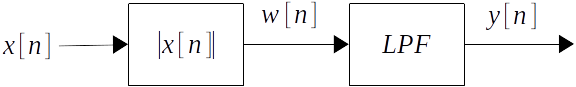

where $w[n] = |x[n]|$ and $y[n]$ was the output of a low-pass FIR filter (averaging filter). In this exercise, you will re-implement this low-pass filter as an IIR.</b>

**1.1 First, copy the functions envelope and synthesize from previous work and obtain the same synthesis.**



In [3]:
def synthesize(f0, phi, Ak, t):
    y = 0
    for k in range(1, 9 + 1):
        y += Ak[k-1] * np.cos(2*np.pi*k*f0*t + k*phi - (k-1)*np.pi/2)
    return y

def envelope_fir(x, N):
    if N < 1:
      raise ValueError("N must be at least 1")
    rectified_signal = np.abs(x)
    filter_coeffs = np.ones(N) / N
    envelope_signal = np.convolve(rectified_signal, filter_coeffs, mode='same')
    return envelope_signal

**1.2 Let's take a look at the following system:**

$$
H(z) = G\frac{1+z^{-1}}{1-rz^{-1}} \quad 0<r<1 \quad, G = \frac{1-r}{2}
$$

Note that the coefficients of the filter are the following:

$$
b_0 = 1, \quad b_1 = 1, \quad a_0 = 1, \quad a_1 = -r, \quad
$$

**i. Find the zeros and poles of the system analytically.**

To find analytically the zeros and poles, we have to check when the numerator and the denominator have roots. The zeros are associated with the zeros of the numerator, that is, the values where $H(z) = 0$, and the poles are associated with the zeros of the denominator, where $H(z) = \infty$ (this expression is written in a vague notation). 

We can also deduce this system will only have a single zero and pole, since both numerator and denominator are from grade 1.

First we deduce the zero:
$$
H(z) = G\frac{1+z^{-1}}{1-rz^{-1}} = 0 \implies 1+z^{-1} = 0 \implies z^{-1} = -1  \implies z = -1
$$

Then, we deduce the pole:
$$
H(z) = G\frac{1+z^{-1}}{1-rz^{-1}} = \infty \implies 1-rz^{-1} = 0 \implies -rz^{-1} = -1  \implies z^{-1} = 1/r \implies z = r
$$

We have found the zero is located at $z = -1$ and the pole at $z = r$. 

**ii. Use the function `np.roots` to find the zeros and poles using Python. Compare the results with part i.**

To find numerically the zeros and poles, we have to find the coefficients from the numerator and the denominator. First, we have the original expression of the system function, with the G replaced by its value:

$$
H(z) = \frac{1-r}{2}·\frac{1+z^{-1}}{1-rz^{-1}} 
$$

Then, we multiply both fractions and we reach the following expression:

$$
H(z) = \frac{(1-r)+(1-r)z^{-1}}{2-2rz^{-1}}
$$

Next, we multiply both denominator and numerator by $z$ to obtain all complex numbers without negative exponents:

$$
H(z) = \frac{(1-r)z+(1-r)}{2z-2r}
$$

From the previous expression, we obtain the coefficients that multiply the $z$ complex numbers in both the numerator and the denominator:

$$
b_k = [1-r, 1-r]
$$
$$
a_k = [2,-2r]
$$


In [4]:
# Write your code here
r = 0.5

coef_numerator = [1-r, 1-r]
zeros = np.roots(coef_numerator)[0]

coef_denominator = [2, -2*r]
poles = np.roots(coef_denominator)[0]

assert zeros == -1
assert poles == r

**iii. Use the function  `plot_zeros_poles(z, p)` to plot the zeros and poles found in ii.**

In [5]:
plot_zeros_poles(zeros, poles)

**1.3 Let's see the frequency response of this filter:**



In [6]:
ww = np.arange(-np.pi, np.pi, np.pi/500)
G = (1 - r)/2
r = 0.5
_, HH = signal.freqz([G, G], [1 , -r], ww)

plot_frequency_response(ww, HH)

**1.4. Change the parameter $r$ in the range $(0, 1)$. What happens when $r$ is increased?**

In [7]:
ww = np.arange(-np.pi, np.pi, np.pi/500)
G = (1 - r)/2
r = 0.99
_, HH = signal.freqz([G, G], [1 , -r], ww)

plot_frequency_response(ww, HH)

As the $r$ value increases, the frequency range which is amplified by the filter shrinks more an more.

**1.5 What type of filter is (low-pass, band-pass, or high-pass filter)?**


We can see this filter is a low-pass one because it amplifies the lower frequencies and supresses the higher ones.

**1.6 Now we can use this IIR filter to extract the envelope. Let's define a new function `envelope_iir(x)` that applies the filter to the absolute value of the signal. Note that we are using signal.lfilter function to apply the filter.**


In [8]:
def envelope_iir(x, r=0.995):
  G = (1 - r)/2
  y = signal.lfilter([G, G], [1, -r], np.abs(x))
  return y

**Extract the envelope of your reference signal using both the FIR and IIR filters and compare the results plot them along with the signal. Change the value of $r$ until you are comfortable with the result.**

In [9]:
# Load reference signal: sound of a piano note
filepath = folder + "piano-a4-sound.wav"
ref, fs = load_audio(filepath)

# Reference signal parameters
fs = 44100
f0 = 440
T0 = 1/f0

env_fir = envelope_fir(ref, 300)
env_iir = envelope_iir(ref)

num_periods_shown = 380
t_start = 0.15
t_end = t_start + T0*num_periods_shown

plot_signals([ref, 1.4*env_fir], fs, t_start=t_start, t_end=t_end, name=['Original signal', 'Envelope FIR'])
plot_signals([ref, 1.4*env_iir], fs, t_start=t_start, t_end=t_end, name=['Original signal', 'Envelope IIR'])

**1.7 What are the main differences between the two filters? For instance, compare the number of coefficients.**

We can see one of the main differences is that, when seeing both envelopes zoomed, the IIR envelope contains more impredictible variations than the FIR one. The FIR envelope is more smooth than the IIR.

Another difference is that the IIR filter is more accurate following the shape of the signal than the FIR one. This is explained because the more coefficients uses the FIR filter, the less accurate is. The  values that take the FIR filter to compute the $y[n]$ are far away from the original $x[n]$ value, then, the $y[n]$ can express something else different. For example, the range in the first tenths of seconds, we can observe there is a range which the signal is $0$, and when we compute the FIR filter, it appears a transitive section where those points are not real values.

**1.8 Apply the new envelope (extracted from the IIR filter) to the synthesis generated with the `synthesize` function and listen to the result.**

In [10]:
# Sample Frequency-Amplitude pairs
spectrum = np.array([0.129200, 1.000000, 0.045950, 0.046560, 0.094700, 
                     0.046840, 0.009089, 0.002395, 0.001157])

# Create the syntethised signal
time = np.arange(0, ref.shape[0]/fs, 1.0/fs)
syn = synthesize(440, np.pi + 0.9, spectrum, time)

# Normalize the syntethised signal
A0 = 0.16
syn = A0 * (syn / np.max(syn))

# Add envelopes to the synthesis
syn_fir = env_fir * syn
syn_iir = env_iir * syn


In [11]:
# Original Signal
ipd.Audio(ref, rate=fs)

In [12]:
# Finite Impulse Respone Synthesis
ipd.Audio(syn_fir, rate=fs)

In [13]:
# Infinite Impulse Respone Synthesis
ipd.Audio(syn_iir, rate=fs)

We have listen the original signal and the synthesis from the IIR filter. We also have added the synthesis from the FIR filter to do a better comparison. 

We have listen that the IIR filter it is similar to the FIR synthesis, and also it is similar to the original signal.

---

## **2. Band-pass filters**

<b>Now let's work with the following system: 

$$
H(z) = \frac{(1-z^{-1})(1+z^{-1})}{(1-re^{j\omega_n}z^{-1})(1-re^{-j\omega_n}z^{-1})}, \quad 0<r<1
$$

Note that the poles are $p_1 = re^{j\omega_n}$ and $p_2 = re^{-j\omega_n}$; and the zeros are $z_1=1$ and $z_2=-1$.</b>

<b>2.1 Use the function `plot_zeros_poles` to plot the zeros and poles of the system.

Note: use $w_n = \pi/4$ and $r=0.99$.</b>

In [14]:
# Write your code here
wn = np.pi/4
r = 0.99

plot_zeros_poles([1, -1], [r*np.exp(1j * wn), r*np.exp(-1j * wn)])

**2.2 Show analytically that $a_k = [1, -2rcos(\omega_n), r^2]$ and $b_k=[1, 0, -1]$.**

First, we develop the the products in parenthesis:

$$
H(z) = \frac{(1-z^{-1})1+(1-z^{-1})z^{-1}} {(1-re^{j\omega_n}z^{-1})1+(1-re^{j\omega_n}z^{-1})re^{-j\omega_n}z^{-1}},
$$

We reexpress the products as:
$$
H(z) = \frac{1-z^{-1}+z^{-1}+(-z^{-1})(z^{-1})} {1-re^{j\omega_n}z^{-1}-re^{-j\omega_n}z^{-1}+(-re^{j\omega_n}z^{-1})(-re^{-j\omega_n}z^{-1})}
$$

And we simplify them as:
$$
H(z) = \frac{1-z^{-2}} {1-r(e^{j\omega_n}+e^{-j\omega_n})z^{-1}+r^2e^{j\omega_n-j\omega_n}z^{-2}}
$$

Knowing the facts that, $\forall\theta\in\Re$, $2cos(\theta)=e^{j\theta}+e^{-j\theta}$ and $e^{j0} = 1$, then:

$$
H(z) = \frac{1-z^{-2}} {1-2rcos(\omega_n)z^{-1}+r^2z^{-2}}
$$

Therefore, the $a_k$ coeficients are those that multiply all the $z^{-k}$ values in the denominator and the $b_k$ coeficients are those that multiply all the $z^{-k}$ values in the numerator:

$$
B(z) = (1)z^{-0}+(0)z^{-1}+(-1)z^{-1} \implies b_k = [1, 0, -1]
$$
$$
A(z) = (1)z^{-0}+(-2rcos(\omega_n))z^{-1}+(r^2)z^{-2} \implies a_k = [1, -2rcos(\omega_n), r^2]
$$

Finally, we can see the coeficients are $a_k = [1, -2rcos(\omega_n), r^2]$ and $b_k=[1, 0, -1]$.

**2.3 Plot the frequency response of the filter. Confirm this is a band-pass filter. What's the central frequency of the passband?**

In [15]:
wn = np.pi/4
r = 0.99
bk = [1, 0, -1]
ak = [1, -2*r*np.cos(wn), r**2]

_, HH = signal.freqz(bk, ak, ww)

plot_frequency_response(ww, HH)

It is a band-pass filter because it only apmlifies one specific frequency and deletes the others. The central frequency of this band pass filter is $\omega_n = \pi/4$.

<b>2.4 Define a function `bpf(x, f, r, fs)` that applies the above band-pass filter. 

Note 1: remember that a frequency can be converted to the normalized radian frequncy by: $\omega_n = 2\pi f_n/f_s$.

Note 2: use `signal.lfilter` function to implement the filter.</b>

In [16]:
def bpf(x, fn, fs, r=0.995):
    wn = 2*np.pi*fn/fs
    bk = [1, 0, -1]
    ak = [1, -2*r*np.cos(wn), r**2]    
    y = signal.lfilter(bk, ak, x)
    return y

<b>2.5 Regardless of the phase, until now we were synthesizing the instrument signal by summing $K$ harmonics of the signal with different weights ($A_k$) and multiplying the sum by the envelope of the reference signal ($e(t)$):

$$y(t) = e(t) \cdot \sum_{k=1}^K A_k\cos\left(2\pi kf_0 t \right), $$

where $f_0$ is the fundamental frequency of the note. Now we want to improve this synthesis by finding a time-dependent amplitude ($A_k(t)$) for each harmonic:

$$y(t) = \sum_{k=1}^K A_k(t) \cos\left(2\pi kf_0 t \right), $$

where $A_k(t)$ is the amplitude of the harmonic $k$. To extract the amplitudes $A_k(t)$ we'll apply a band-pass filter with central frequency $kf_0$ and calculate the envelope of the output by using the `envelope_iir`.</b>


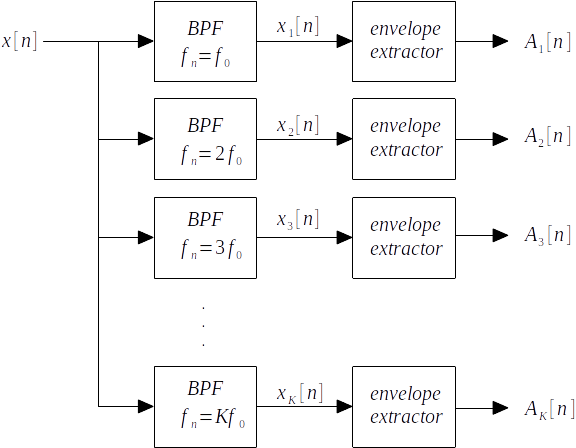

<b>For instance, the following code should extract the envelope of the fundamental frequency component. Change the value of $f_0$ to coincide with your fundamental frequency and check the result.</b>

In [17]:
x_1 = bpf(ref, 5*f0, fs)
A_1 = envelope_iir(x_1, r=0.999)
plot_signals([x_1, A_1], fs, t_start=t_start, t_end=t_end, name=['x_1(t)', 'A_1(t)'])

In [18]:
# Band-Pass Filter Synthesis for Fundamental Frequency
ipd.Audio(x_1, rate=fs)

**2.6 Complete the `synthetize_with_bpf` function to implement a synthesis applying different envelopes for each harmonic.**


In [19]:
def synthetize_with_bpf(x, f0, phi, K, fs):
  Ts = 1/float(fs)
  t = np.arange(0, len(x)*Ts, Ts)

  y = 0
  for k in range(1, int(K) + 1):
    x_k = bpf(x, k*f0, fs)
    A_k = envelope_iir(x_k, r=0.999)
    y += A_k * np.cos(2*np.pi*k*f0*t + k*phi - (k-1)*np.pi/2)

  y = np.amax(x)*y/np.amax(y) # normalize the output
  return y

<b>2.6 Call the function `synthetize_with_bpf` to get the synthesized signal and **listen to it**.

Note that now you can increase the number of harmonics $K$ as you want because we are not manually measuring the weights of each harmonic.</b>

We will use nine harmonics since it is the number of harmonics we have sinthetized in the previous labs.

In [20]:
num_harmonics = 9
syn_bpf = synthetize_with_bpf(ref, f0, 0, num_harmonics, fs)

<b>2.7 Compare the **spectrograms** of the synthesized signal and reference signal.</b>

*a) Comparison of spectrograms*

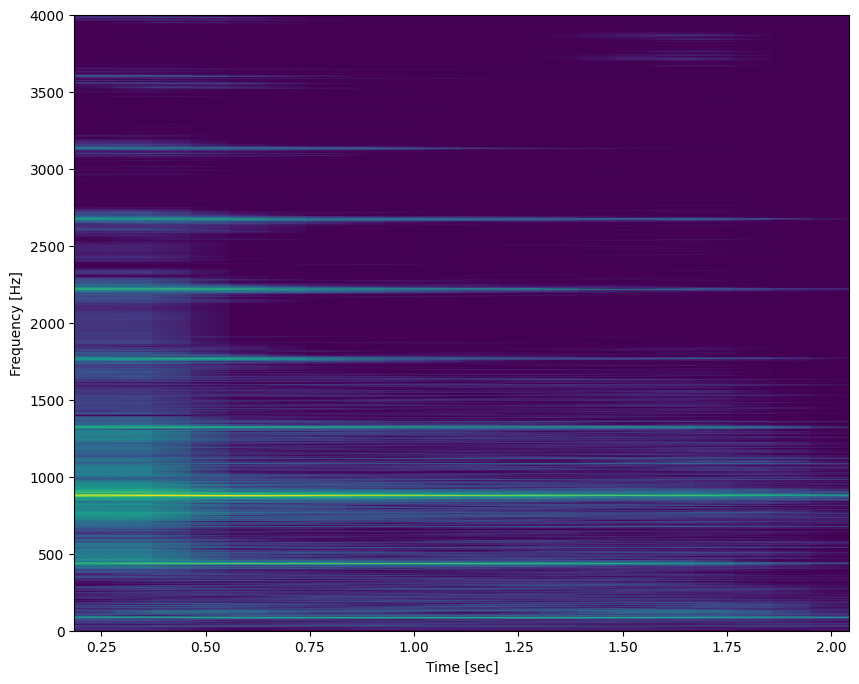

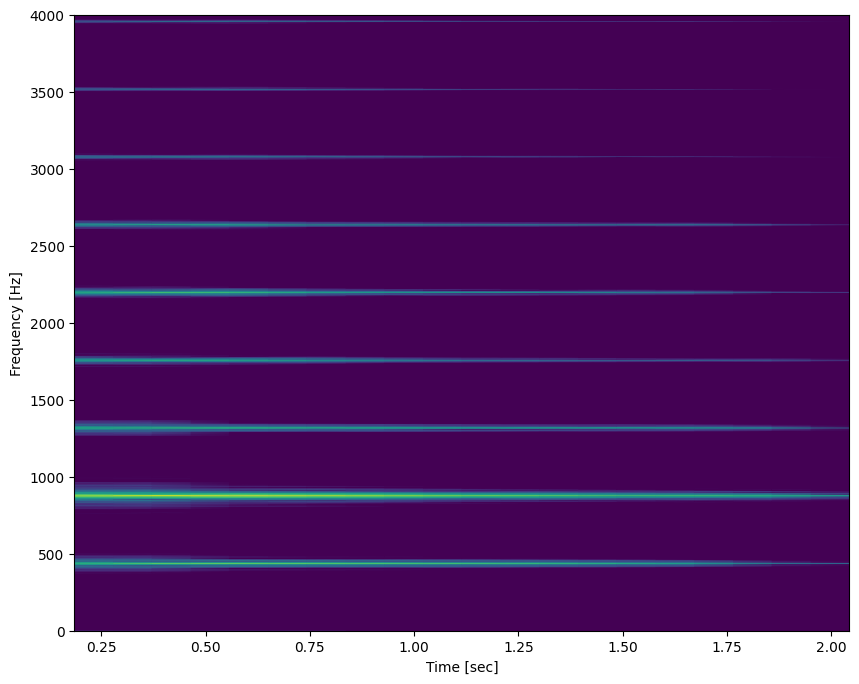

In [21]:
# Spectrogram of Original Signal 
window_length = 8192*2
ff, tt, S = signal.spectrogram(ref, fs, nperseg=window_length, noverlap=window_length/2)
plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0, 4000])
plt.show()

# Spectrogram of Synthetized Signal with Band-Pass Filter 
ff, tt, Sy = signal.spectrogram(syn_bpf, fs, nperseg=window_length, noverlap=window_length/2)
plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, Sy)
plt.ylim([0, 4000])
plt.show()

We can see on the comparison of the spectrograms that the reference signal has more noise on the lower frequencies and on the first intants of seconds. The sinthesis has an unnoticeable noise. It is also appreciated that both signals follow the same pattern for the amplitude values: the higher the frequency is, the lower the amplitude value has the sinusoid component. The second harmonic frequency it is the one with high amplitude in both cases.

*b) Extra comparison: time-amplitude plots*

On the one hand, if we do zoom out, we can see the shapes of the signals are a little bit different. Firstly, on the bigining, we can see the synthetises has less attack compared the reference signal. In addition, the shape of the synthesis uses to be more smooth than the reference.

In the other hand, we do zoom in, we can observe the signals are very similar shape. They have almost the same fundamental period and the crests are similar, too.

In [22]:
plot_signals([ref, syn_bpf], fs, t_start=t_start, t_end=t_end, 
             name=['Original Signal', 'Band-Pass Filter Synthesis'])
plot_signals([ref, syn_bpf], fs, t_start=0.354, t_end=0.372, 
             name=['Original Signal', 'Band-Pass Filter Synthesis'])

*c) Extra comparison: audios*

When comparing the audios obtained from the reference signal and the synthesis, we can listen the difference on the attack and also on the timbre. The synthesis has less atack, since we have seen on the time-amplitude plot. Furthermore, the sound we percieve from the synthesis seem to have more warm sound, like a wind instrument instead of a keyboard.

In [23]:
# Original Signal
ipd.Audio(ref, rate=fs)

In [24]:
# Band-Pass Filter Synthesis
ipd.Audio(syn_bpf, rate=fs)